## problem formulation

Let $I \subset \mathbb{R}$ be an interval. Let $\{(\xi_+^i, \xi_-^i)\}_{i=1}^N \subset I\times I$ be given.

Conider $x'(t) = f(x(t), t) : \mathbb{R}^n \times \mathbb{R}_+ \to \mathbb{R}^n$, such that:

- $f(x(t), t) = f_+(x(t), t) = A_+ x + b_+ $ for $t \in ...$
- $f(x(t), t) = f_-(x(t), t) = A_- x + b_-$ for $t \in ...$

Objetivo: $\phi(t)$ solucion para todo $t \geq 0$.

$\phi(t) = e^{A(t-t_0)}\phi(t_0) + \int_{t_0}^{t} e^{A(t-s)}b~ds$.

$s' = s - t_0 \Rightarrow ds' = ds$, and 

$\int_{t_0}^{t} e^{A(t-s)}b_+ds = \int_{0}^{t-t_0} e^{A(t-(s' + t_0))}b~ds' = e^{-A t_0} \int_{0}^{t-t_0} e^{A(t-s)}b~ds$

$\boxed{\phi(t) = e^{A(t-t_0)}\phi(t_0) + e^{-A t_0} \int_{0}^{t-t_0} e^{A(t-s)}b~ds}$

Caso particular $t_0 = 0$,

$\boxed{\phi(t) = e^{At}\phi(0) + \int_{0}^{t} e^{A(t-s)}b~ds}$

Caso particular escalar $n = 1$,

$$
\phi(t) = e^{\alpha(t-t_0)}\phi(t_0) + e^{-\alpha t_0} \int_{0}^{t-t_0} e^{\alpha(t-s)}\beta~ds 
$$

usamos que

$$
\int_0^t e^{\mu s}ds = \frac{e^{\mu~t} - 1}{\mu}
$$

$$
\phi(t) = e^{\alpha(t-t_0)}\phi(t_0) + \beta~e^{-\alpha t_0}e^{\alpha t} \dfrac{1 - e^{-\alpha(t - t_0)}}{\alpha}
$$

$$
\phi(t) = e^{\alpha(t-t_0)}\phi(t_0) +  \dfrac{\beta}{\alpha} \left( e^{\alpha(t-t_0)} - 1 \right)
$$

$$
\boxed{\phi(t) = e^{\alpha(t-t_0)}\left( \phi(t_0) +  \dfrac{\beta}{\alpha} \right) - \dfrac{\beta}{\alpha}}
$$

In [ ]:
# exp(α*(t-t0))*(ϕt0 + β/α) - β/α

---

**primer periodo:**

- $[0, \color{red}{t_+ + \xi_+^1}] \to f_+$

- $[\color{red}{t_+ + \xi_+^1}, \color{blue}{t_-} + \color{red}{t_+ + \xi_+^1} + \color{blue}{\xi_-^1}] \to f_-$

**segundo periodo:**

- $[\color{red}{t_+ + \xi_+^1} + \color{blue}{t_-+\xi_-^1}, \color{red}{t_+ + \xi_+^1} + \color{blue}{t_-+\xi_-^1} + \color{green}{t_+ + \xi_+^2}] \to f_+$

- $[\color{red}{t_+ + \xi_+^1} + \color{blue}{t_-+\xi_-^1} + \color{green}{t_+ + \xi_+^2}, \color{red}{t_+ + \xi_+^1} + \color{blue}{t_-+\xi_-^1} + \color{green}{t_+ + \xi_+^2} + \color{blue}{t_-+\xi_-^2}] \to f_-$

**periodo k-esimo:** $k \geq 1$

- $[\color{blue}{(k-1)(t_+ + t_-)  + \sum_{i=1}^{k-1} (\xi_+^i + \xi_-^i)}, \color{green}{kt_+ + (k-1) t_-  + \sum_{i=1}^k \xi_+^i + \sum_{i=1}^{k-1} \xi_-^i}] \to f_+$

- $[\color{green}{kt_+ + (k-1) t_-  + \sum_{i=1}^k \xi_+^i + \sum_{i=1}^{k-1} \xi_-^i}, \color{red}{k(t_+ + t_-)  + \sum_{i=1}^k (\xi_+^i + \xi_-^i)}] \to f_-$

**intervalo de tiempo del periodo $k$-esimo**

- $T_k = \color{red}{k(t_+ + t_-)  + \sum_{i=1}^k \xi_+^i + \xi_-^i}$ para $k\geq 1$.

## implementation

In [1]:
using Distributions

# parametros para las funciones analiticas
α₊ = -1.0
β₊ = 1.0

α₋ = -1.0
β₋ = -1.0

# funciones analiticas
ϕ₊(t, t0, ϕt0) = exp(α₊*(t-t0))*(ϕt0 + β₊/α₊) - β₊/α₊
ϕ₋(t, t0, ϕt0) = exp(α₋*(t-t0))*(ϕt0 + β₋/α₋) - β₋/α₋

# funciones de corte en el tiempo
left_times₊(k, t₊, t₋, ξ₋, ξ₊) = (k-1) * (t₊ + t₋) + sum(ξ₊[1:k-1] + ξ₋[1:k-1])
right_times₊(k, t₊, t₋, ξ₋, ξ₊) = k*t₊ + (k-1)*t₋ + sum(ξ₊[1:k]) + sum(ξ₋[1:k-1])

left_times₋(k, t₊, t₋, ξ₋, ξ₊) = right_times₊(k, t₊, t₋, ξ₋, ξ₊)
right_times₋(k, t₊, t₋, ξ₋, ξ₊) = k* (t₊ + t₋) + sum(ξ₊[1:k] + ξ₋[1:k])

# solucion analitica donde N es el numero de periodos que quiero calcular
function solucion_analitica(N, ϕt0_ini, t₊, t₋, ξ₋, ξ₊; Δ=1e-1)
    
    ϕval = [[] for _ in 1:N]
    tiempos = [[] for _ in 1:N]

    for k in 1:N

        # first semi-period
        ϕt0 = k == 1 ? ϕt0_ini : ϕval[k-1][end]
        l = left_times₊(k, t₊, t₋, ξ₋, ξ₊)
        u = right_times₊(k, t₊, t₋, ξ₋, ξ₊)
        dt₊ = range(l, u, step=Δ)
        t0 = l
        sol₊ = ϕ₊.(dt₊, t0, ϕt0)

        # second semi-period
        l = left_times₋(k, t₊, t₋, ξ₋, ξ₊)
        u = right_times₋(k, t₊, t₋, ξ₋, ξ₊)
        dt₋ = range(l, u, step=Δ)
        t0 = l
        ϕt0 = sol₊[end]
        sol₋ = ϕ₋.(dt₋, t0, ϕt0)

        tiempos[k] = vcat(dt₊, dt₋)
        ϕval[k] = vcat(sol₊, sol₋)
    end
    return tiempos, ϕval
end

solucion_analitica (generic function with 1 method)

In [2]:
using Plots

In [3]:
gr()

Plots.GRBackend()

  0.774691 seconds (1.40 M allocations: 68.839 MiB, 6.61% gc time)


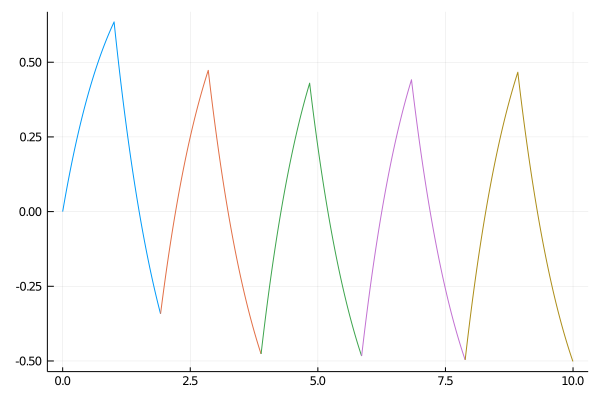

In [4]:
N = 5
I = Uniform(-0.1, 0.1);
ϕt0_ini = 0.0
t₊, t₋, ξ₋, ξ₊ = 1.0, 1.0, rand(I, N), rand(I, N)
@time tiempos, sol = solucion_analitica(N, ϕt0_ini, t₊, t₋, ξ₋, ξ₊; Δ=1e-3);

plot(tiempos, sol, markerstyle=:scatter, lab="")

In [5]:
N = 10
I = Uniform(-0.05, 0.05);

fig = plot()
for i in 1:20
    ϕt0_ini = 0.0
    t₊, t₋, ξ₋, ξ₊ = 1.0, 1.0, rand(I, N), rand(I, N)
    tiempos, sol = solucion_analitica(N, ϕt0_ini, t₊, t₋, ξ₋, ξ₊; Δ=1e-3);
    plot!(fig, tiempos, sol, markerstyle=:scatter, lab="")
end
return fig

## solucion varias corridas

In [16]:
function solucion_corridas(NRUNS, N, ϕt0_ini, t₊, t₋;
                           Δ=1e-1, δ=0.01, I=Uniform(-δ, δ))

    tiempos = [[] for _  in 1:NRUNS]
    sol = [[] for _ in 1:NRUNS]

    #fig = plot()
    for i in 1:NRUNS
        t₊, t₋, ξ₋, ξ₊ = 1.0, 1.0, rand(I, N), rand(I, N)
        tiempos[i], sol[i] = solucion_analitica(N, ϕt0_ini, t₊, t₋, ξ₋, ξ₊; Δ=1e-3)
        #plot!(fig, tiempos, sol, markerstyle=:scatter, lab="")
    end
    #return fig
    return tiempos, sol
end

solucion_corridas (generic function with 2 methods)

In [17]:
NRUNS = 200
N = 21
δ = 0.01
I = Uniform(-δ, δ);
ϕt0_ini = 0.0
t₊, t₋ = 1.0, 1.0
@time tiempos, sol = solucion_corridas(NRUNS, N, ϕt0_ini, t₊, t₋; Δ=1e-1, δ=δ);

  6.272904 seconds (97.03 M allocations: 1.783 GiB, 39.47% gc time)


In [18]:
fig = plot()
for i in 1:NRUNS
    plot!(fig, tiempos[i][20:21], sol[i][20:21], markerstyle=:scatter, lab="")
end
fig

In [19]:
20*0.02

0.4

In [20]:
using LazySets, ModelingToolkit

var = @variables x y
P = HPolyhedron([40 - 0.2 <= x, x <= 40 + 0.2], var)
plot!(deepcopy(fig), P, lab="")

---

## Valores extremos

In [21]:
gr()

Plots.GRBackend()

In [28]:
NRUNS = 1
N = 21
δ = 0.01
I = Uniform(-δ, -δ+1e-10);
ϕt0_ini = 0.0
t₊, t₋ = 1.0, 1.0
@time tiempos, sol = solucion_corridas(NRUNS, N, ϕt0_ini, t₊, t₋; Δ=1e-1, I=I);

  0.020564 seconds (478.73 k allocations: 8.956 MiB)


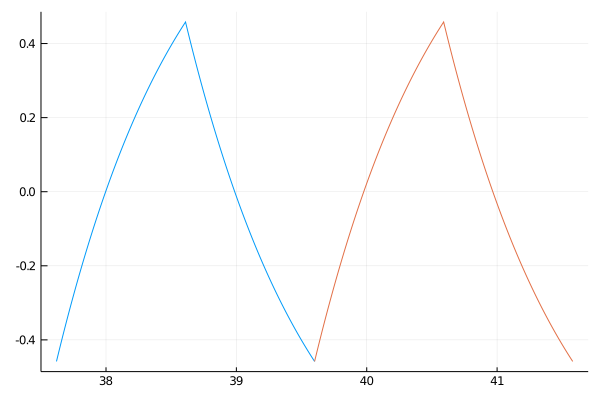

In [29]:
fig = plot()
for i in 1:NRUNS
    plot!(fig, tiempos[i][20:21], sol[i][20:21], markerstyle=:scatter, lab="")
end
fig

In [30]:
NRUNS = 1
N = 21
δ = 0.01
I = Uniform(δ, δ+1e-10);
ϕt0_ini = 0.0
t₊, t₋ = 1.0, 1.0
@time tiempos, sol = solucion_corridas(NRUNS, N, ϕt0_ini, t₊, t₋; Δ=1e-1, I=I);

  0.008795 seconds (488.81 k allocations: 9.143 MiB)


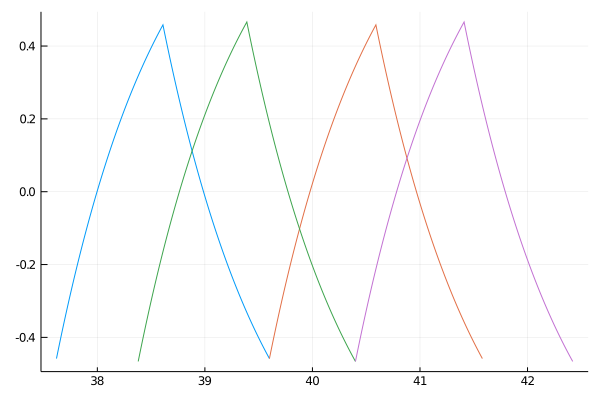

In [31]:
for i in 1:NRUNS
    plot!(fig, tiempos[i][20:21], sol[i][20:21], markerstyle=:scatter, lab="")
end
fig

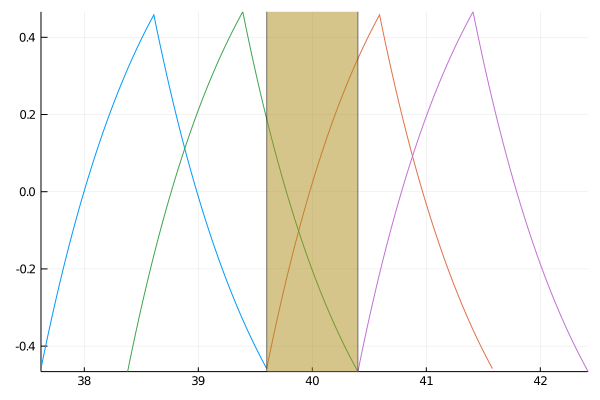

In [32]:
P = HPolyhedron([40 - 0.4 <= x, x <= 40 + 0.4], var)
plot!(deepcopy(fig), P, lab="")

----

## Termino derecho de la ODE

$\{0, T_1, T_2, T_3, ..., T_k, ...\}$

In [ ]:
using Distributions
I = Uniform(-0.1, 0.1);

In [ ]:
T(k, t₊, t₋, ξ₋, ξ₊) = k == 0 ? 0.0 : k*(t₊ + t₋) + sum(ξ₋[1:k] + ξ₊[1:k])

In [ ]:
ξ₋ = rand(I, 10)
ξ₊ = rand(I, 10)
[T(i, 1.0, 1.0, ξ₋, ξ₊) for i in 0:10]

In [ ]:
t = 10

In [ ]:
f₊(x) = A₊*x + b₊
f₋(x) = A₋*x + b₋

# vector con el tiempo final de cada periodo,
# 0, T1, T2, T3, ..., Tk, ...
function f(x, t, t₊, t₋, ξ₋, ξ₊)
    k = 0
    Tk = 0.0
    while t > Tk
        k += 1
        Tk = T(k, t₊, t₋, ξ₋, ξ₊)
    end

    k = 0 && return f₊(x)

    # t ∈ [T_{k-1}, T_k]
    Tk₋₁ = T(k-1, t₊, t₋, ξ₋, ξ₊)
    cond = t - Tk₋₁ ≤ t₊ + ξ₊[k]

    return cond ? f₊(x) : f₋(x)
end

In [ ]:
using LazySets
const IA = LazySets.IntervalArithmetic

In [ ]:
ξ₊ = IA.Interval(-0.1, 0.1)
ξ₋ = IA.Interval(-0.1, 0.1)

In [ ]:
50(ξ₊ + ξ₋)

In [ ]:
100(ξ₊ + ξ₋)